In [1]:
import cv2 
import os 
import numpy as np 
import matplotlib.pyplot as plt

# Funciones auxiliares 

In [2]:

def get_concat_h(im1, im2):
    """concatena dos imagenes una al lado de la otra"""
    dst = Image.new('RGB', (im1.width + im2.width, im1.height))
    dst.paste(im1, (0, 0))
    dst.paste(im2, (im1.width, 0))
    return dst

In [3]:

def plot_image(image_1, image_2,title_1="Orignal",title_2="New Image"):
    """Visualiza imagenes"""
    plt.figure(figsize=(10,10))
    plt.subplot(1, 2, 1)
    plt.imshow(image_1,cmap="gray")
    plt.title(title_1)
    plt.subplot(1, 2, 2)
    plt.imshow(image_2,cmap="gray")
    plt.title(title_2)
    plt.show()

In [4]:
def plot_hist(old_image, new_image,title_old="Orignal", title_new="New Image"):
    intensity_values=np.array([x for x in range(256)])
    plt.subplot(1, 2, 1)
    plt.bar(intensity_values, cv2.calcHist([old_image],[0],None,[256],[0,256])[:,0],width = 5)
    plt.title(title_old)
    plt.xlabel('intensity')
    plt.subplot(1, 2, 2)
    plt.bar(intensity_values, cv2.calcHist([new_image],[0],None,[256],[0,256])[:,0],width = 5)
    plt.title(title_new)
    plt.xlabel('intensity')
    plt.show()


In [5]:
def thresholding(input_img,threshold,max_value=255, min_value=0):
    N,M=input_img.shape
    image_out=np.zeros((N,M),dtype=np.uint8)
        
    for i  in range(N):
        for j in range(M):
            if input_img[i,j]> threshold:
                image_out[i,j]=max_value
            else:
                image_out[i,j]=min_value
                
    return image_out  

Agrega directorio de imagenes

In [13]:
my_image = "David.jpeg"
cwd = os.getcwd()
image_path = os.path.join(cwd, my_image)
image_path

'c:\\Users\\Admin\\Documents\\util\\David.jpeg'

<function matplotlib.pyplot.show(close=None, block=None)>

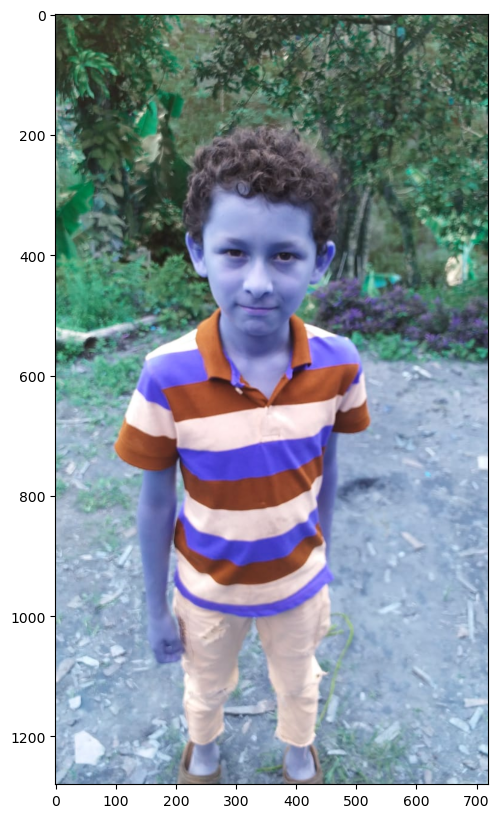

In [14]:
image=cv2.imread(my_image)
plt.figure(figsize=(10,10))
plt.imshow(image)
plt.show

In [15]:
print(f"Tipo:{type(image)}\nTamaño:{image.shape}\nMáximo valor:{image.max()}\nMínimo Valor:{image.min()}")

Tipo:<class 'numpy.ndarray'>
Tamaño:(1280, 720, 3)
Máximo valor:255
Mínimo Valor:0


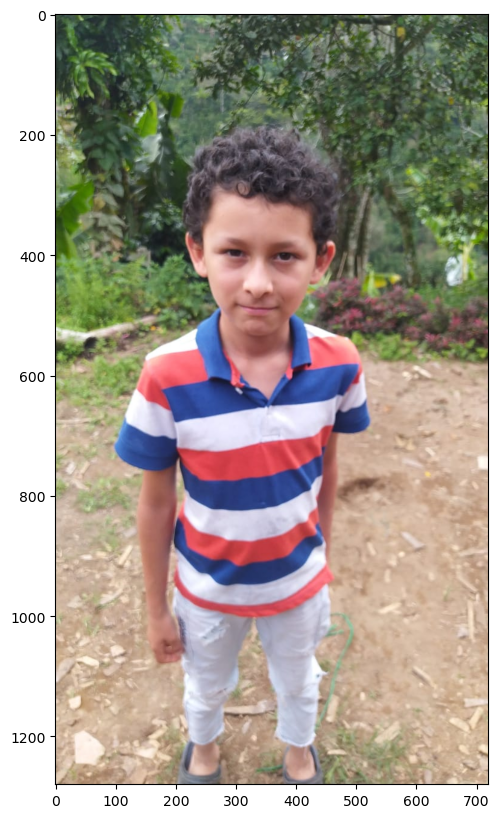

In [16]:
new_image=cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(10,10))
plt.imshow(new_image)
plt.show()

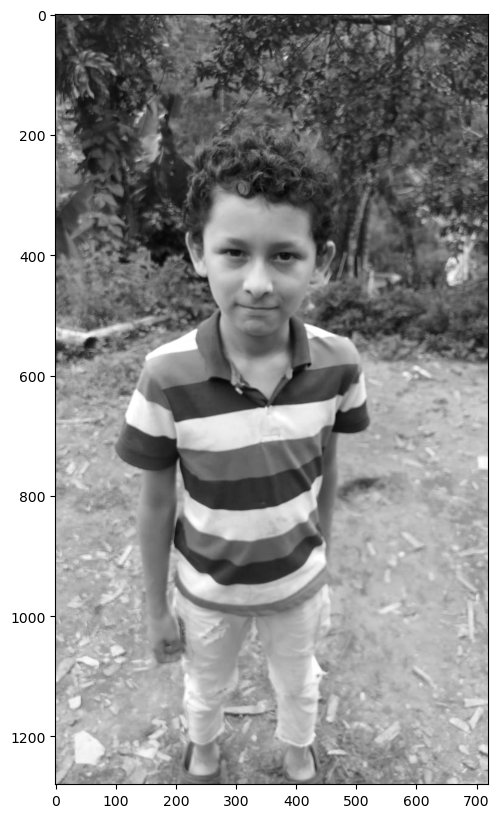

In [17]:
image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
plt.figure(figsize=(10, 10))
plt.imshow(image_gray, cmap='gray')
plt.show()

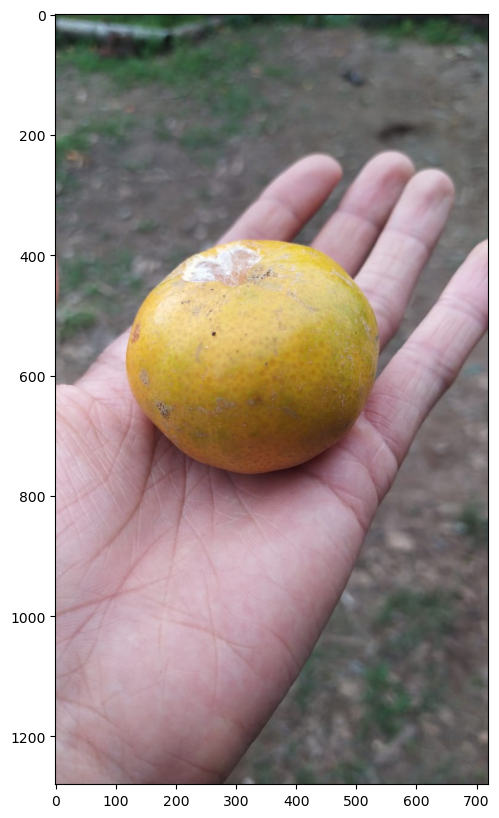

In [18]:
mandarina=cv2.imread('Mandarina.jpeg')
plt.figure(figsize=(10,10))
plt.imshow(cv2.cvtColor(mandarina, cv2.COLOR_BGR2RGB))
plt.show()

## Descomponer imagen en sus canales

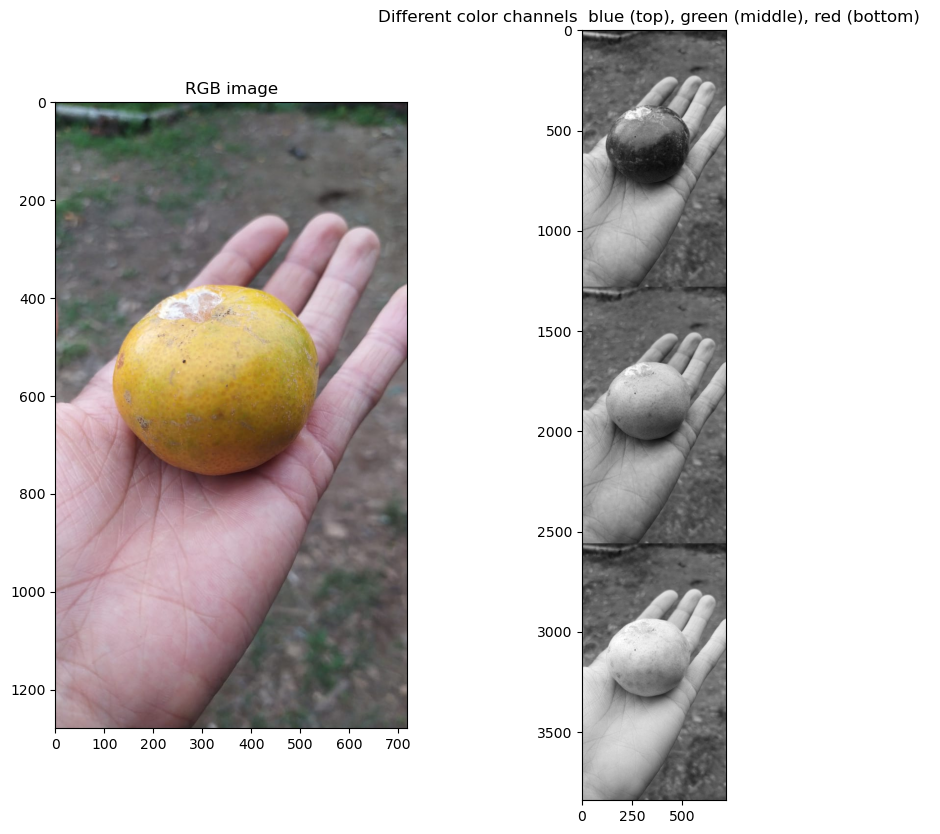

In [23]:
blue, green, red = mandarina[:, :, 0], mandarina[:, :, 1], mandarina[:, :, 2]

im_bgr = cv2.vconcat([blue, green, red])
plt.figure(figsize=(10,10))
plt.subplot(121)
plt.imshow(cv2.cvtColor(mandarina, cv2.COLOR_BGR2RGB))
plt.title("RGB image")
plt.subplot(122)
plt.imshow(im_bgr,cmap='gray')
plt.title("Different color channels  blue (top), green (middle), red (bottom)  ")
plt.show()

## Recortar  

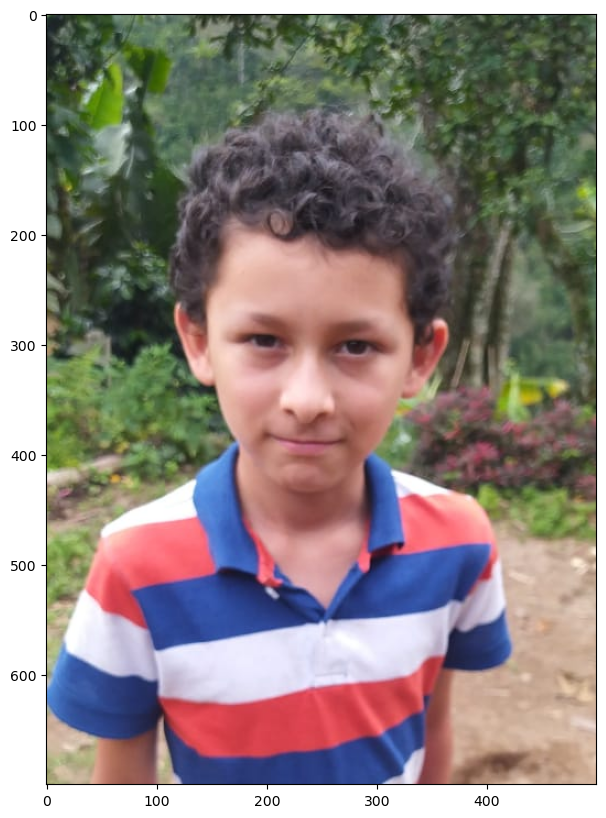

In [32]:

plt.figure(figsize=(10,10))
plt.imshow(new_image[100:800, 100:600,:])
plt.show()

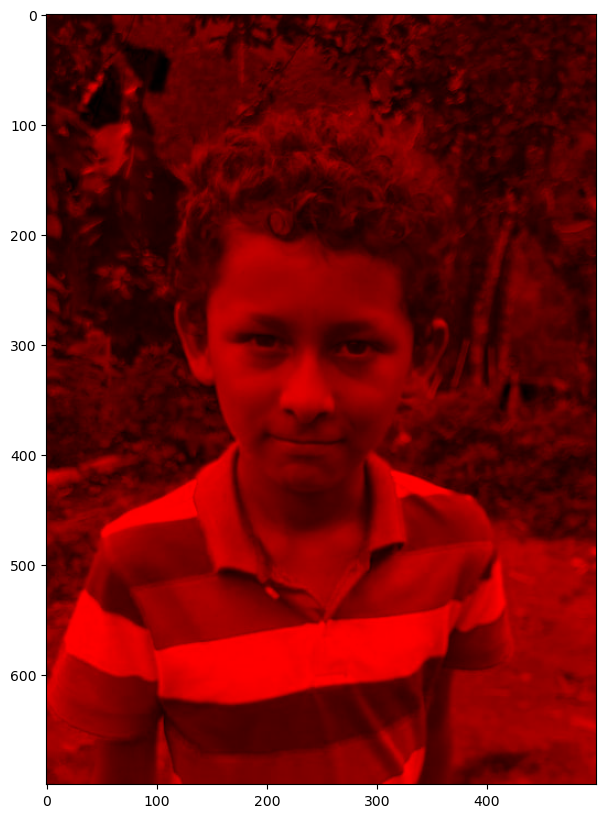

In [33]:
#Recuerde que el programa trabaja con BGR
david_r = new_image[100:800, 100:600,:].copy()
david_r[:, :, 0] = 0 
david_r[:, :, 1] = 0
plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(david_r, cv2.COLOR_BGR2RGB))
plt.show()

## rotar
Para rotar una imágen en OpenCV se usa la función flip(), que tiene el parámetro flipCode</code>así:

flipcode = 0: Verticalmente respecto al eje x
flipcode > 0: Horizontalmente respecto al eje y
flipcode < 0: Los dos anteriores juntos

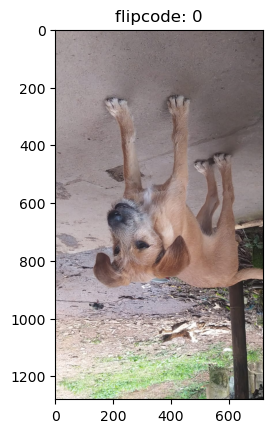

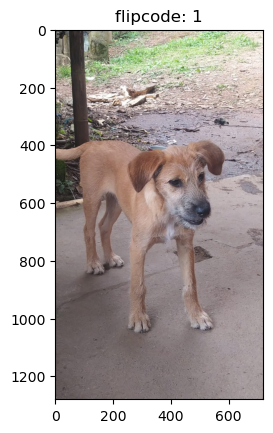

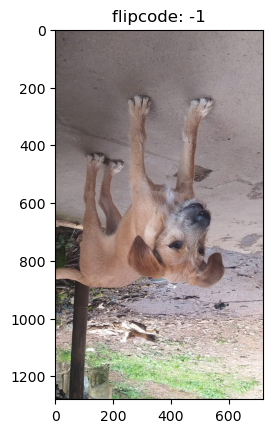

In [104]:
image = cv2.imread("chand.jpeg")
for flipcode in [0,1,-1]:
    im_flip =  cv2.flip(image,flipcode )
    plt.imshow(cv2.cvtColor(im_flip,cv2.COLOR_BGR2RGB))
    plt.title("flipcode: "+str(flipcode))
    plt.show()

También se puede rotar pasandole a la función rotate el argumento correspondiente

cv2.ROTATE_90_CLOCKWISE
cv2.ROTATE_90_COUNTERCLOCKWISE
cv2.ROTATE_180

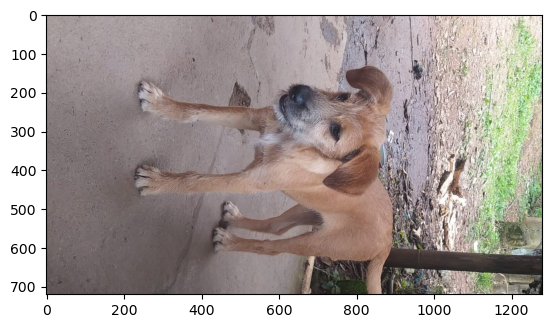

In [39]:
im_flip = cv2.rotate(image,cv2.ROTATE_90_CLOCKWISE)
plt.imshow(cv2.cvtColor(im_flip,cv2.COLOR_BGR2RGB))
plt.show()

## encerrar zona 

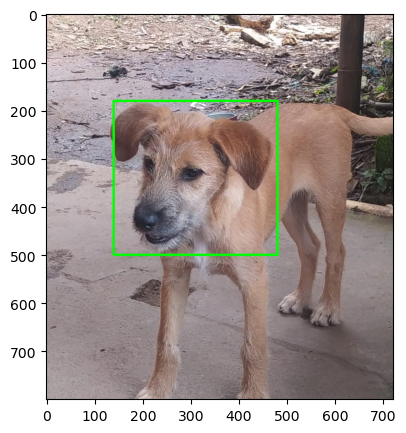

In [46]:
start_point, end_point = (140,180),(480, 500)
image_draw = np.copy(image[200:1000, :,:])
cv2.rectangle(image_draw, pt1=start_point, pt2=end_point, color=(0, 255, 0), thickness=3) 
plt.figure(figsize=(5,5))
plt.imshow(cv2.cvtColor(image_draw, cv2.COLOR_BGR2RGB))
plt.show()

## Deformar

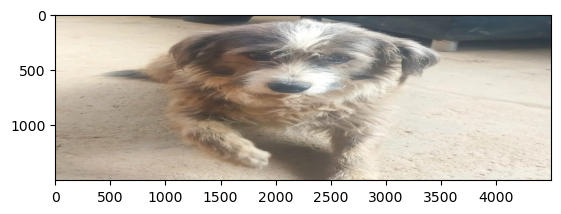

old image shape: (1500, 1500, 3) new image shape: (1500, 4500, 3)


In [127]:
image = cv2.imread("congo.jpeg")
new_image = cv2.resize(image, None, fx=3, fy=1, interpolation=cv2.INTER_CUBIC)
plt.imshow(cv2.cvtColor(new_image, cv2.COLOR_BGR2RGB))
plt.show()
print("old image shape:", image.shape, "new image shape:", new_image.shape)

In [128]:
tx = 100
ty = 0
M = np.float32([[1, 0, tx], [0, 1, ty]])

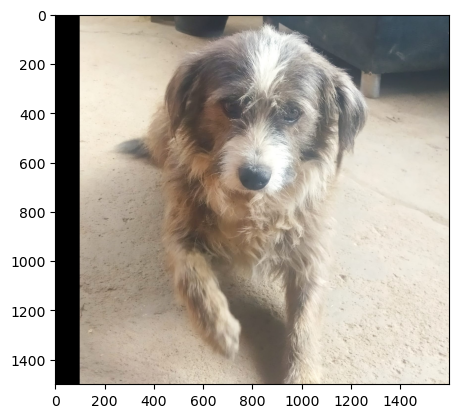

In [129]:
rows, cols, _ = image.shape
new_image = cv2.warpAffine(image, M, (cols + tx, rows + ty))
plt.imshow(cv2.cvtColor(new_image, cv2.COLOR_BGR2RGB))
plt.show()

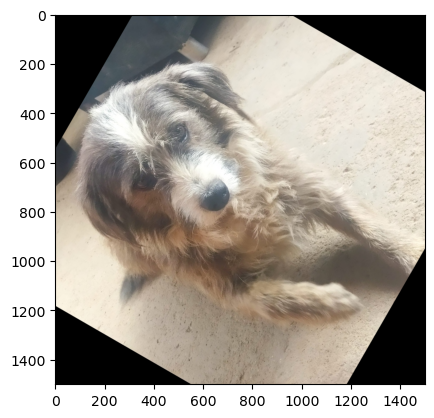

In [130]:
cols, rows, _ = image.shape
theta = 60.0
M = cv2.getRotationMatrix2D(center=(cols // 2 - 1, rows // 2 - 1), angle=theta, scale=1)
new_image = cv2.warpAffine(image, M, (cols, rows))
plt.imshow(cv2.cvtColor(new_image, cv2.COLOR_BGR2RGB))
plt.show()

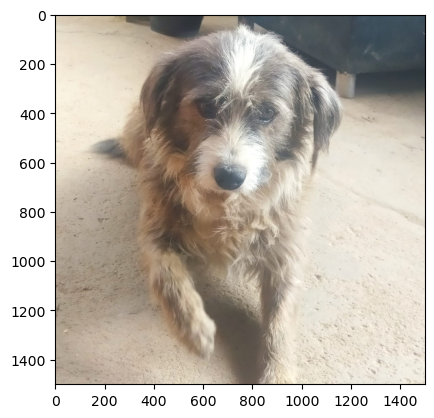

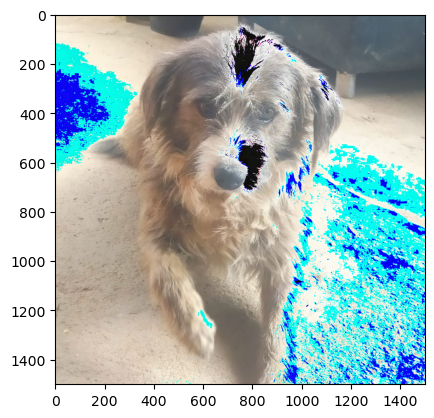

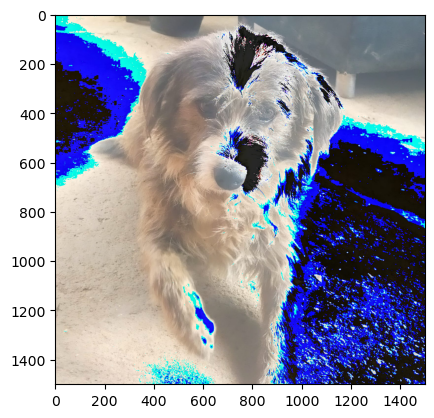

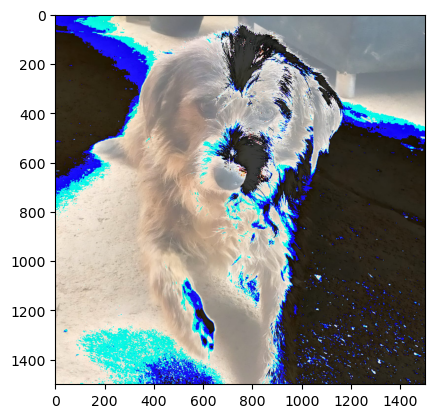

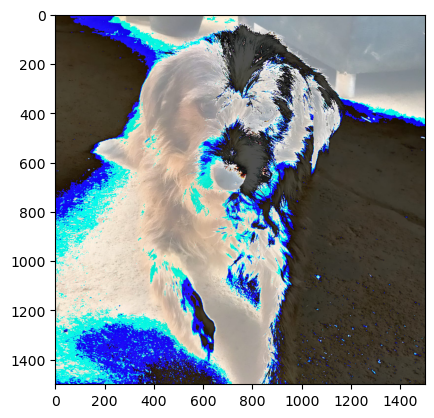

...

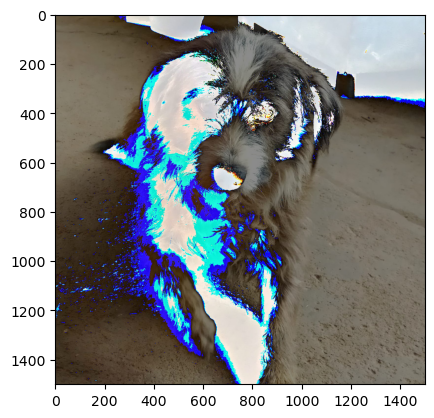

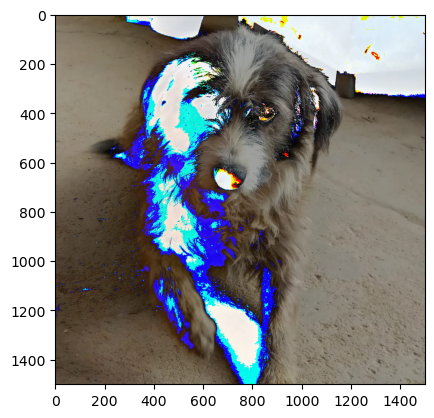

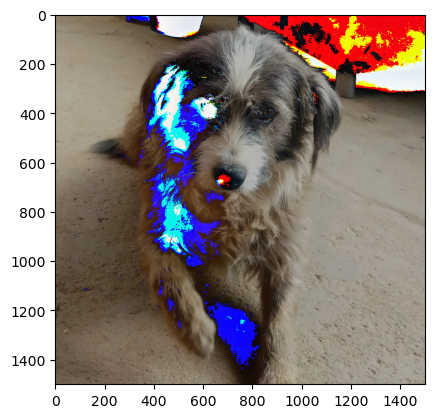

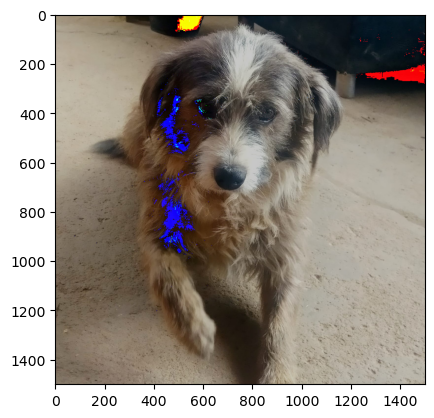

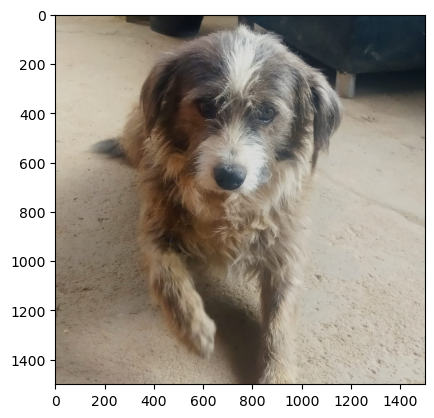

In [131]:
for i in range(0,240,20):
    new_image = image + i
    plt.imshow(cv2.cvtColor(new_image, cv2.COLOR_BGR2RGB))
    plt.show() 


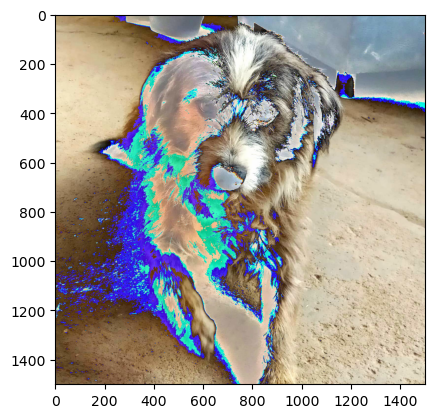

In [132]:
new_image = 2 * image
plt.imshow(cv2.cvtColor(new_image, cv2.COLOR_BGR2RGB))
plt.show()

## Filtros

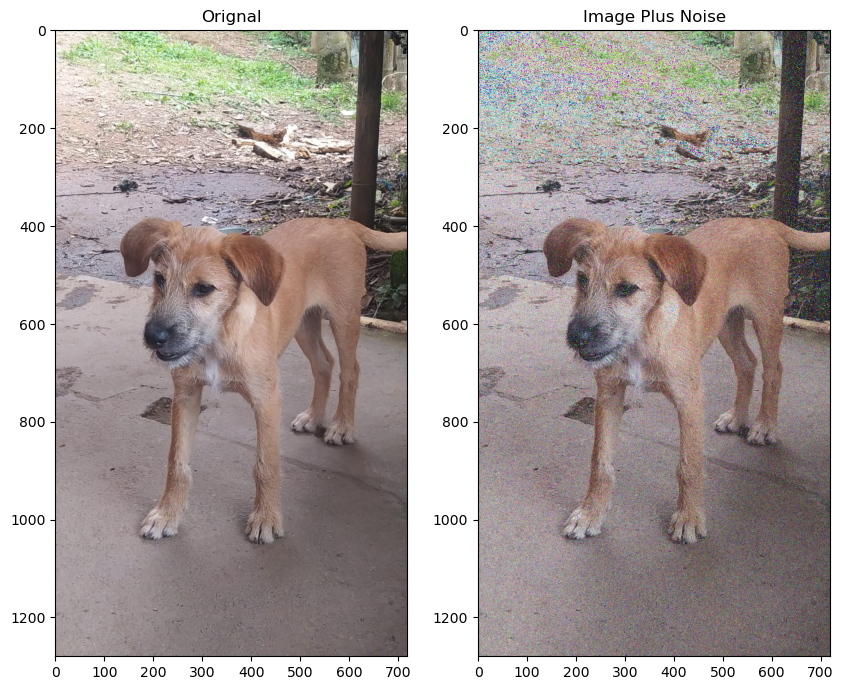

In [75]:
image = cv2.cvtColor(cv2.imread("chand.jpeg"), cv2.COLOR_BGR2RGB)

rows, cols,_= image.shape

noise = np.random.normal(0,25,(rows,cols,3)).astype(np.uint8)

noisy_image = image + noise

plot_image(image, noisy_image, title_1="Orignal",title_2="Image Plus Noise")

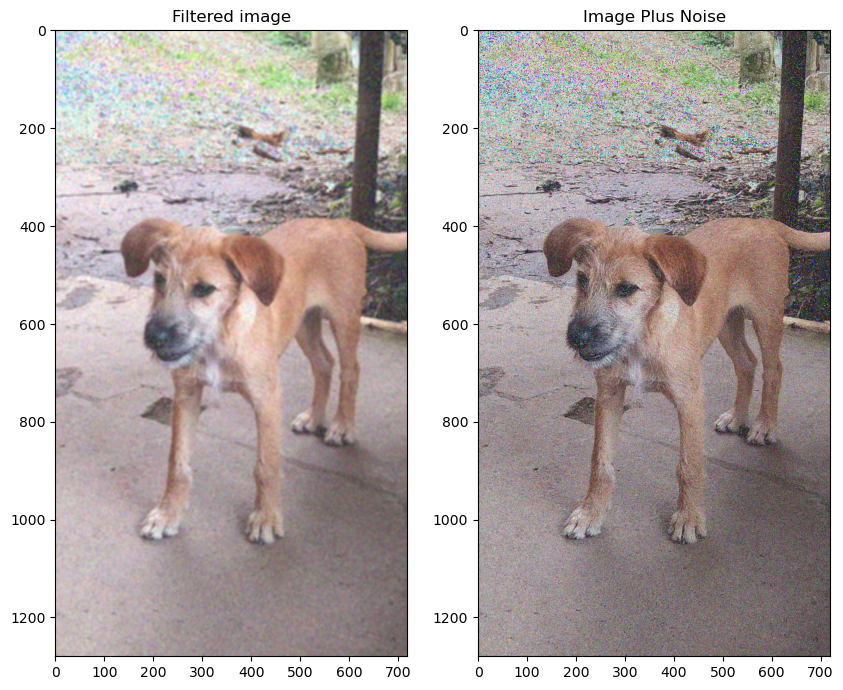

In [85]:
kernel = np.ones((6,6))/30
image_filtered = cv2.filter2D(src=noisy_image, ddepth=-1, kernel=kernel)
#ddepth=-1 para tener la misma profundidad que la imagen original
plot_image(image_filtered, noisy_image,title_1="Filtered image",title_2="Image Plus Noise")

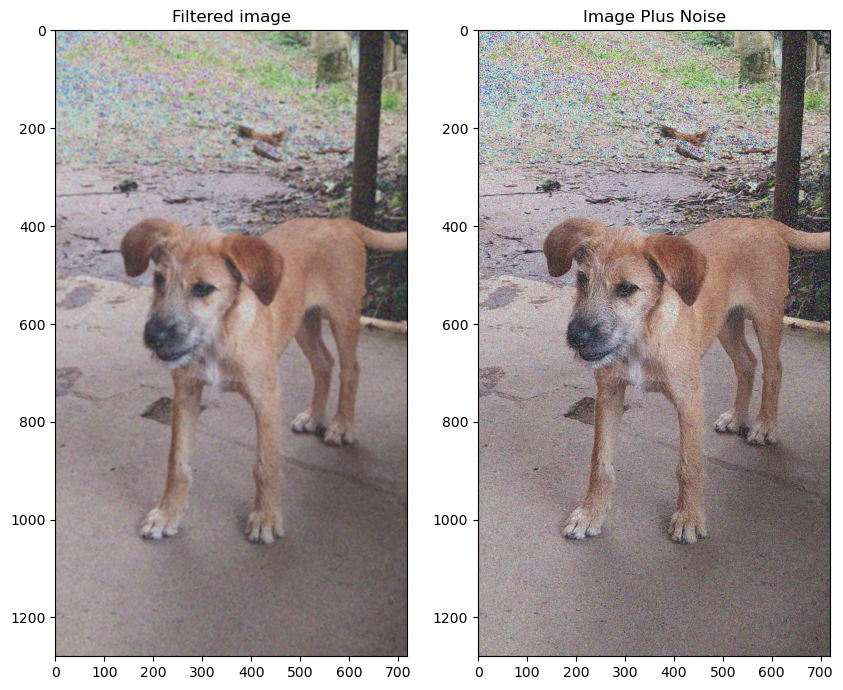

In [89]:
image_filtered = cv2.GaussianBlur(noisy_image,(5,5),sigmaX=4,sigmaY=4)

plot_image(image_filtered , noisy_image,title_1="Filtered image",title_2="Image Plus Noise")

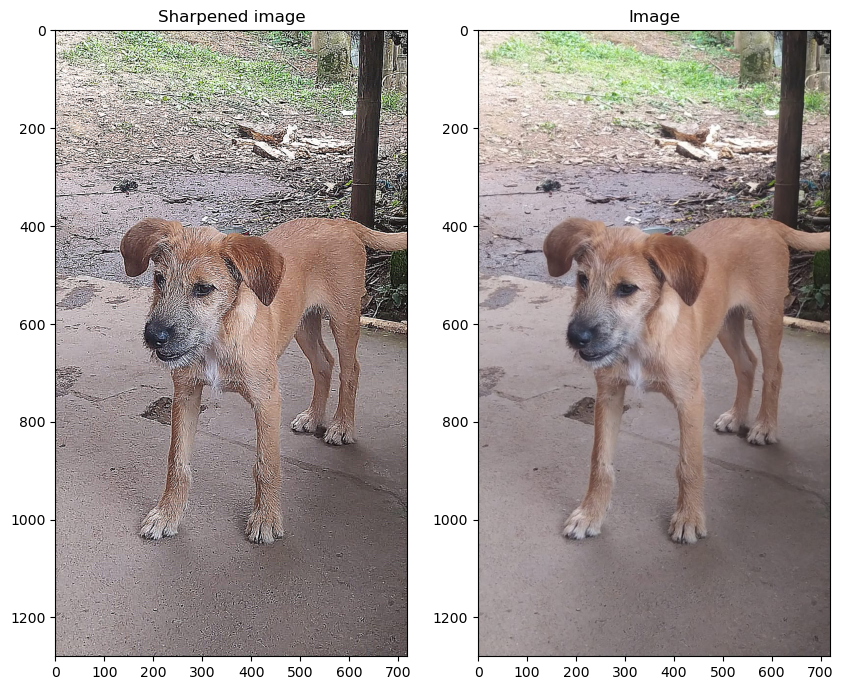

In [93]:
kernel = np.array([[-1,-1,-1], 
                   [-1, 9,-1],
                   [-1,-1,-1]])



sharpened = cv2.filter2D(image, -1, kernel)

plot_image(sharpened , image, title_1="Sharpened image",title_2="Image")

[[ 63  63  63 ... 177 179 180]
 [ 57  58  60 ... 176 178 179]
 [ 52  54  57 ... 175 178 178]
 ...
 [240 219 202 ... 223 222 222]
 [239 217 200 ... 223 223 222]
 [242 219 201 ... 223 222 222]]


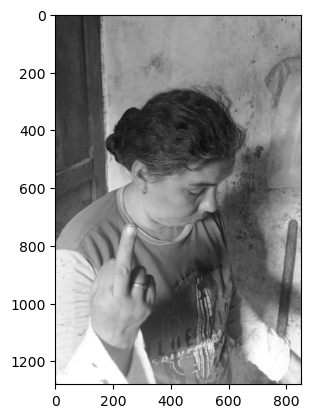

In [94]:
img_gray = cv2.imread("cucha.jpeg", cv2.IMREAD_GRAYSCALE)
print(img_gray)
plt.imshow(img_gray ,cmap='gray')

ddepth: Asociado con el tamaño en memoria de los valores de los pixeles
ksize: Tamaño del kernel
dx: Orden de la derivada en x
dy: Orden de la derivada en y

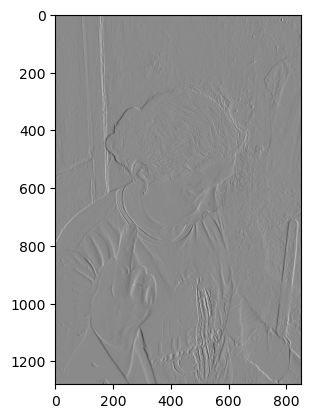

In [98]:

ddepth = cv2.CV_16S

grad_x = cv2.Sobel(src=img_gray, ddepth=ddepth, dx=1, dy=0, ksize=3)
grad_y = cv2.Sobel(src=img_gray, ddepth=ddepth, dx=0, dy=1, ksize=3)
plt.imshow(grad_x,cmap='gray')

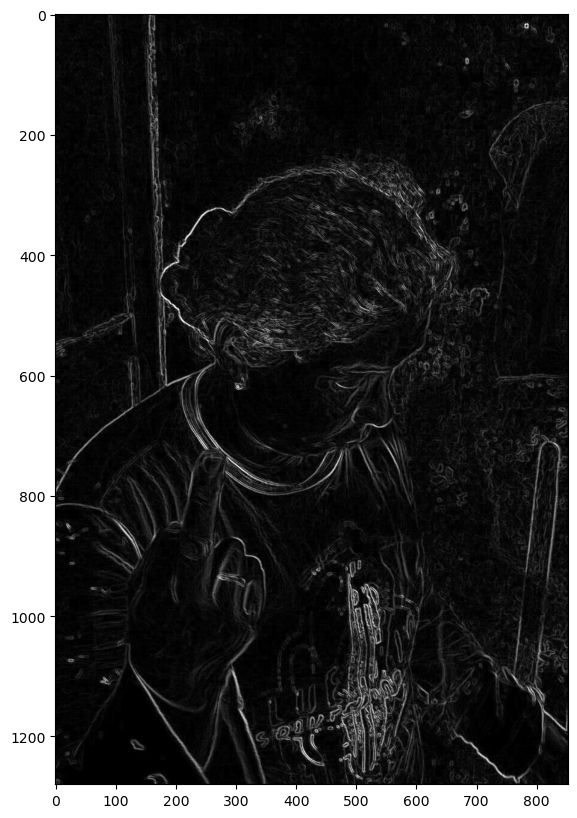

In [99]:
# Convierte nuevamente a un valor entre 0 y 255
abs_grad_x = cv2.convertScaleAbs(grad_x)
abs_grad_y = cv2.convertScaleAbs(grad_y)
#Suma los gradientes
grad = cv2.addWeighted(abs_grad_x, 0.5, abs_grad_y, 0.5, 0)
#Grafica
plt.figure(figsize=(10,10))
plt.imshow(grad,cmap='gray')

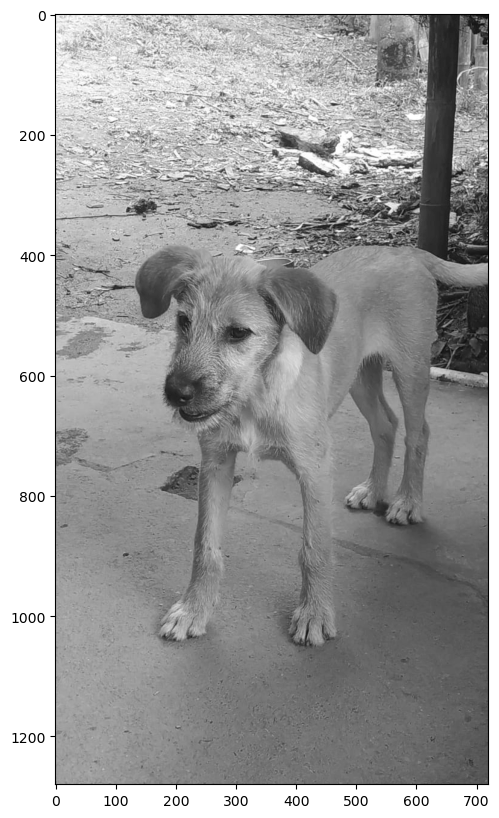

In [106]:
image = cv2.imread("chand.jpeg",cv2.IMREAD_GRAYSCALE)

plt.figure(figsize=(10,10))

plt.imshow(image,cmap="gray")

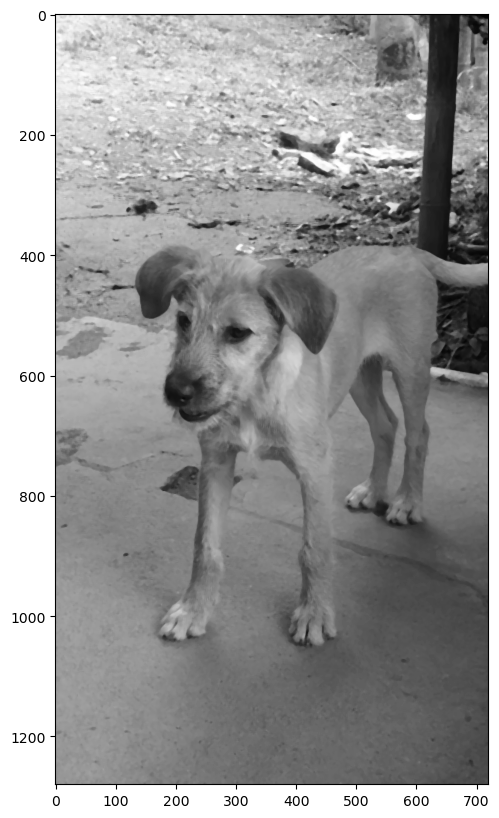

In [114]:
# Median Blurr con kernel de tamaño 5
filtered_image = cv2.medianBlur(image, 5)

plt.figure(figsize=(10,10))

plt.imshow(filtered_image,cmap="gray")

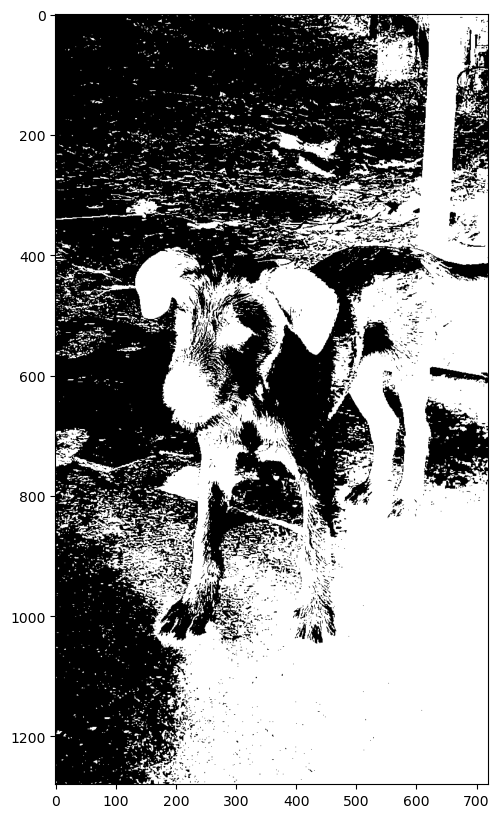

In [108]:
# Retorna el umbral "óptimo"
ret, outs = cv2.threshold(src = image, thresh = 0, maxval = 255, type = cv2.THRESH_OTSU+cv2.THRESH_BINARY_INV)


plt.figure(figsize=(10,10))


plt.imshow(outs, cmap='gray')

## Historama

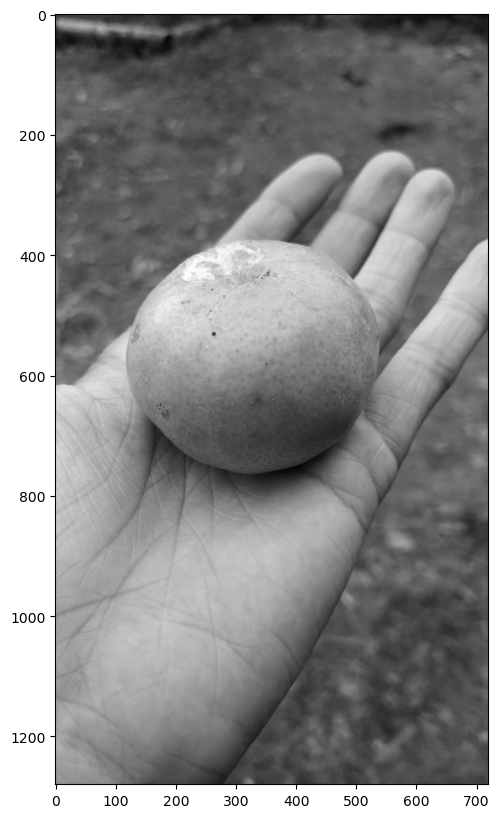

In [123]:
mandarina  = cv2.imread("mandarina.jpeg",cv2.IMREAD_GRAYSCALE)
plt.figure(figsize=(10,10))
plt.imshow(mandarina ,cmap="gray")
plt.show()

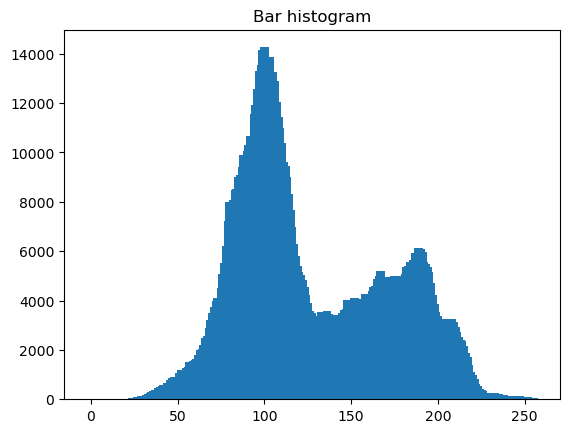

In [124]:
hist = cv2.calcHist([mandarina ],[0], None, [256], [0,256])
intensity_values = np.array([x for x in range(hist.shape[0])])
plt.bar(intensity_values, hist[:,0], width = 5)
plt.title("Bar histogram")
plt.show()

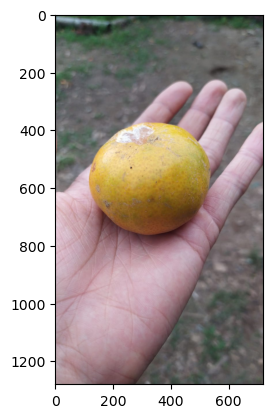

In [156]:
mandarina = cv2.imread("Mandarina.jpeg")
plt.imshow(cv2.cvtColor(mandarina ,cv2.COLOR_BGR2RGB))
plt.show()

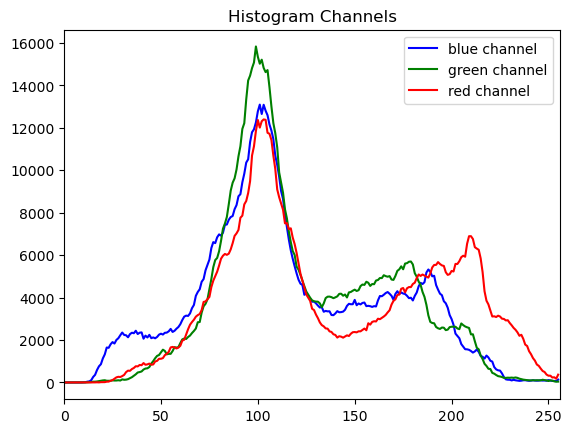

In [126]:
color = ('blue','green','red')
for i,col in enumerate(color):
    histr = cv2.calcHist([mandarina ],[i],None,[256],[0,256])
    plt.plot(intensity_values,histr,color = col,label=col+" channel")
    
    plt.xlim([0,256])
plt.legend()
plt.title("Histogram Channels")
plt.show()

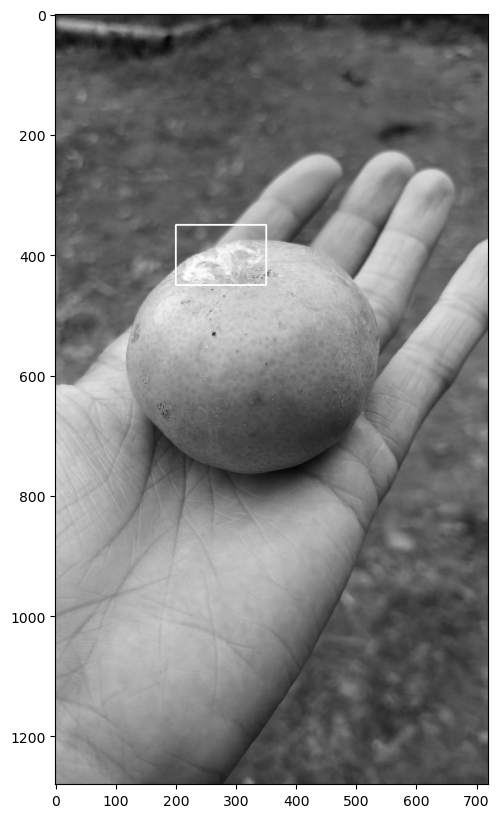

In [137]:
image = cv2.imread("Mandarina.jpeg", cv2.IMREAD_GRAYSCALE)
cv2.rectangle(image, pt1=(200, 350), pt2=(350, 450), color = (255), thickness=2) 

plt.figure(figsize = (10,10))
plt.imshow(image, cmap="gray")
plt.show()

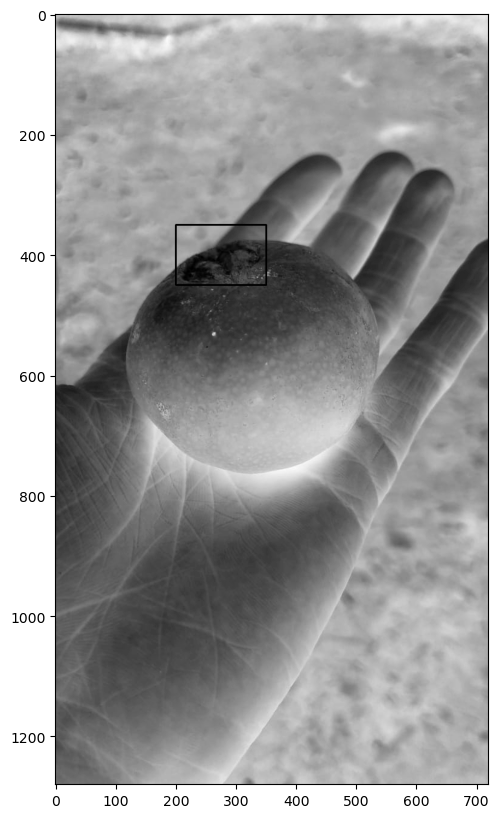

In [140]:
img_neg = -1 * image + 255
plt.figure(figsize=(10,10))
plt.imshow(img_neg, cmap = "gray")
plt.show()

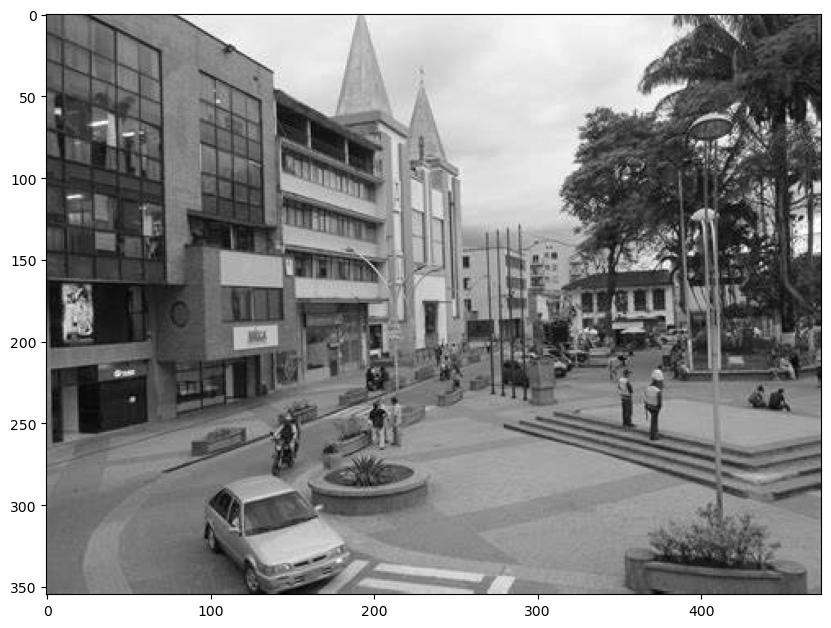

In [142]:
calar = cv2.imread("calarca.jpg",cv2.IMREAD_GRAYSCALE)
plt.figure(figsize=(10,10))
plt.imshow(calar,cmap="gray")
plt.show()

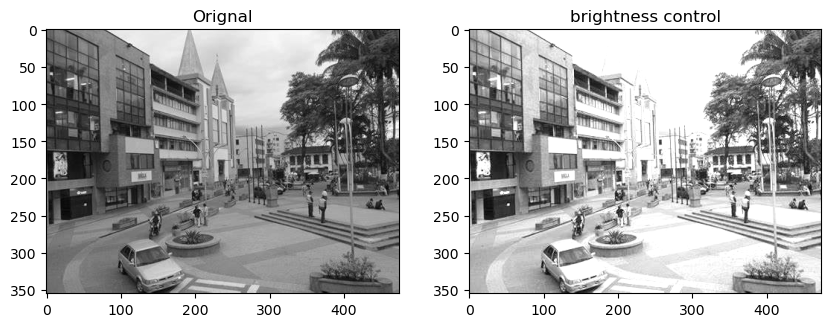

In [148]:
alpha = 1 # Simple contrast control
beta = 100   # Simple brightness control   
new_image = cv2.convertScaleAbs(calar, alpha=alpha, beta=beta)
plot_image(calar, new_image, title_1 = "Orignal", title_2 = "brightness control")

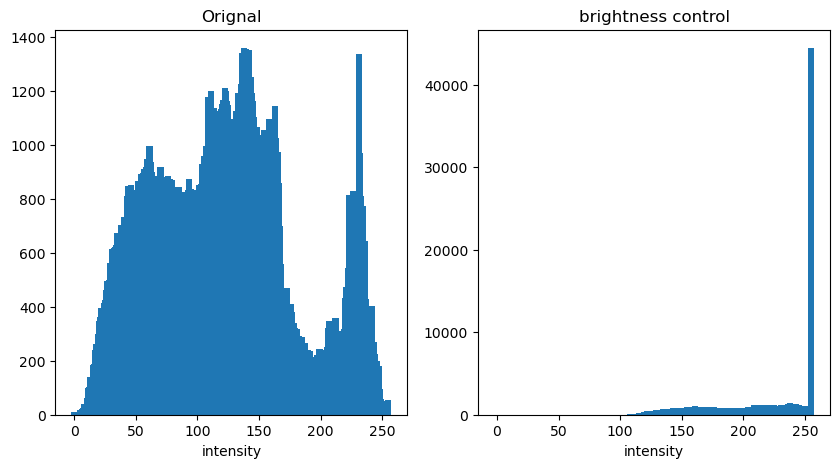

In [149]:
plt.figure(figsize=(10,5))
plot_hist(calar, new_image, "Orignal", "brightness control")

<Figure size 1000x500 with 0 Axes>

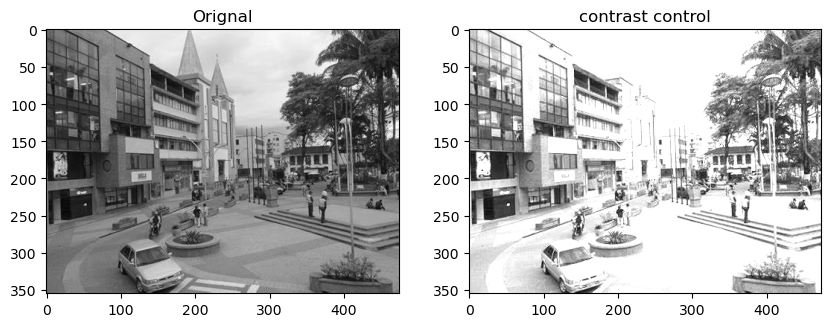

In [151]:
plt.figure(figsize=(10,5))
alpha = 2# Simple contrast control
beta = 0 # Simple brightness control   # Simple brightness control
new_image = cv2.convertScaleAbs(calar, alpha=alpha, beta=beta)
plot_image(calar,new_image,"Orignal","contrast control")

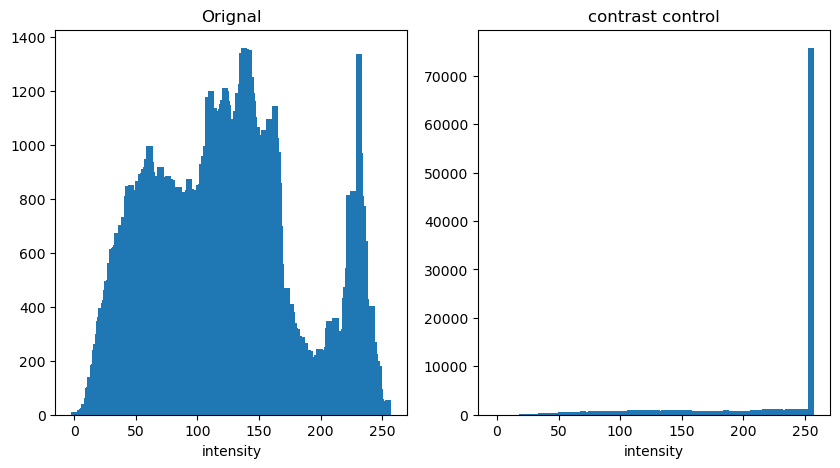

In [153]:
plt.figure(figsize=(10,5))
plot_hist(calar, new_image,"Orignal","contrast control")

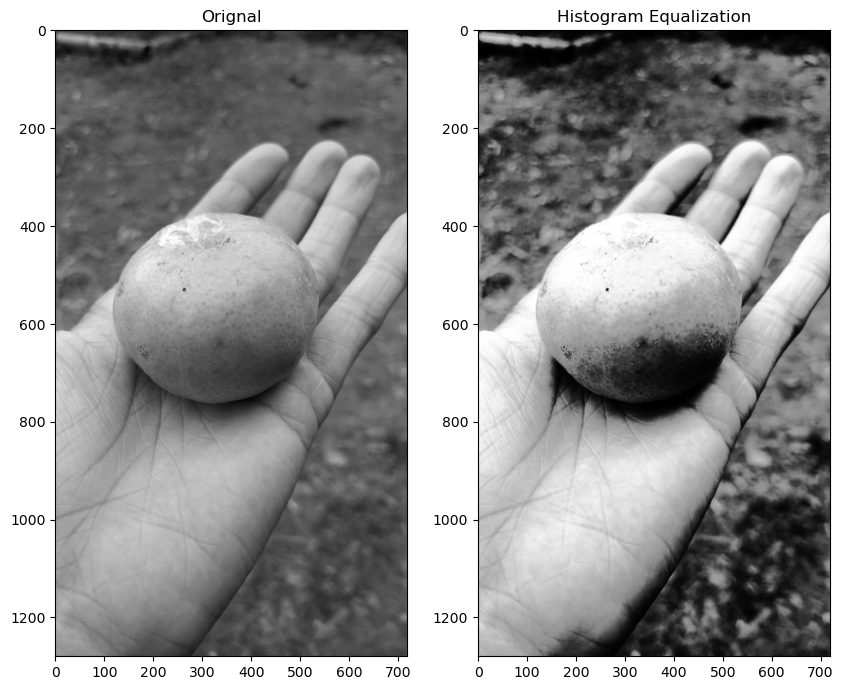

In [159]:
mandarina  = cv2.imread("Mandarina.jpeg",cv2.IMREAD_GRAYSCALE)
new_image = cv2.equalizeHist(mandarina )
plot_image(mandarina ,new_image,"Orignal","Histogram Equalization")

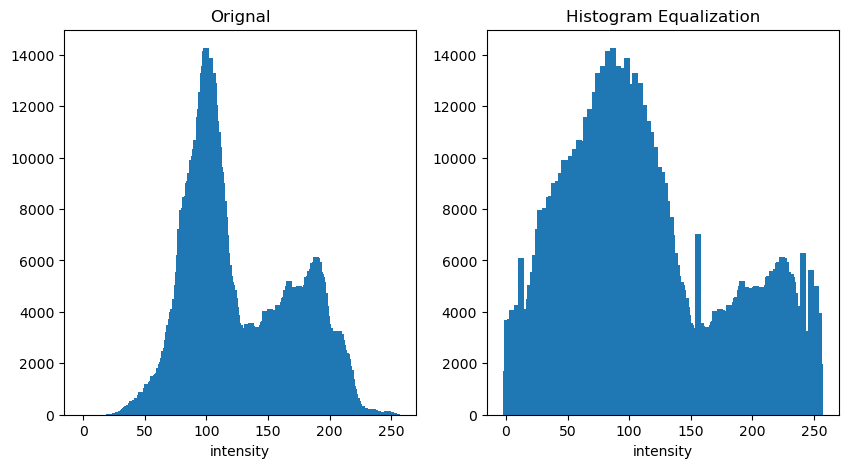

In [161]:

plt.figure(figsize=(10,5))
plot_hist(mandarina, new_image,"Orignal","Histogram Equalization")

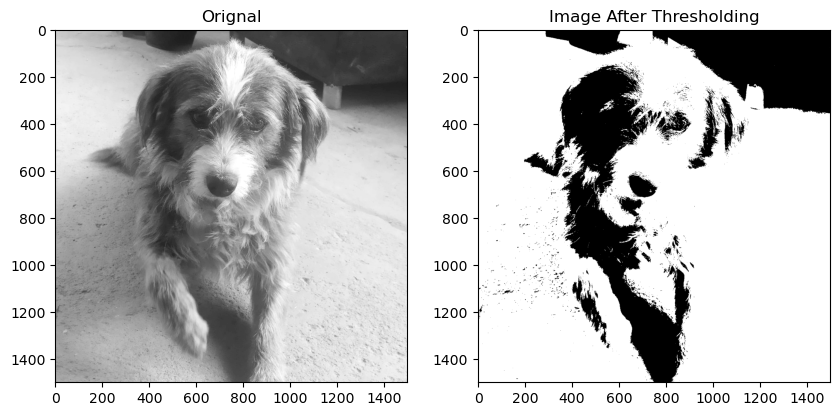

In [165]:
image = cv2.imread("congo.jpeg", cv2.IMREAD_GRAYSCALE)
threshold = 120
max_value = 255
min_value = 0
new_image = thresholding(image, threshold=threshold, max_value=max_value, min_value=min_value)
plot_image(image, new_image, "Orignal", "Image After Thresholding")

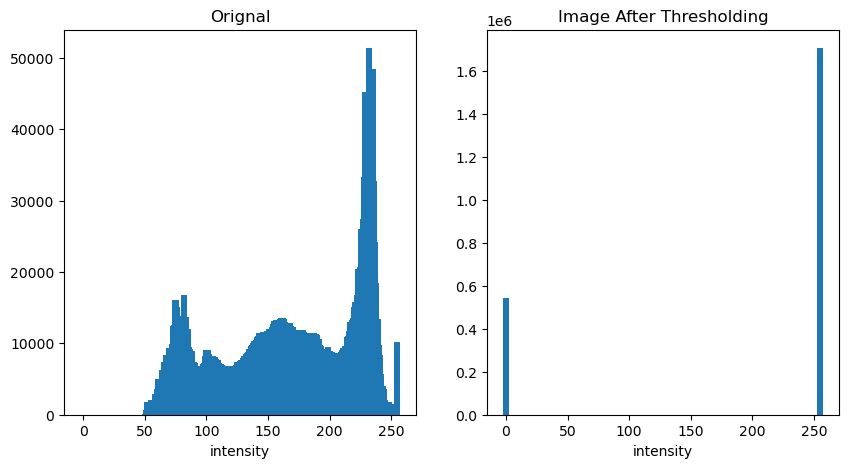

In [166]:
plt.figure(figsize=(10,5))
plot_hist(image, new_image, "Orignal", "Image After Thresholding")

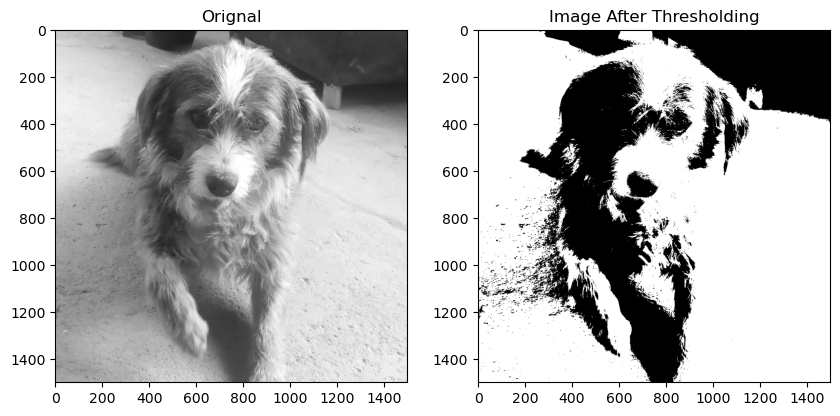

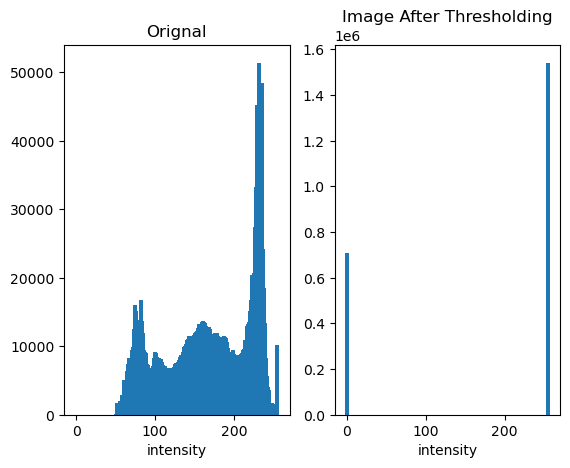

In [167]:
threshold = 140
ret, new_image = cv2.threshold(image,threshold,max_value,cv2.THRESH_BINARY)
plot_image(image,new_image,"Orignal","Image After Thresholding")
plot_hist(image, new_image,"Orignal","Image After Thresholding")

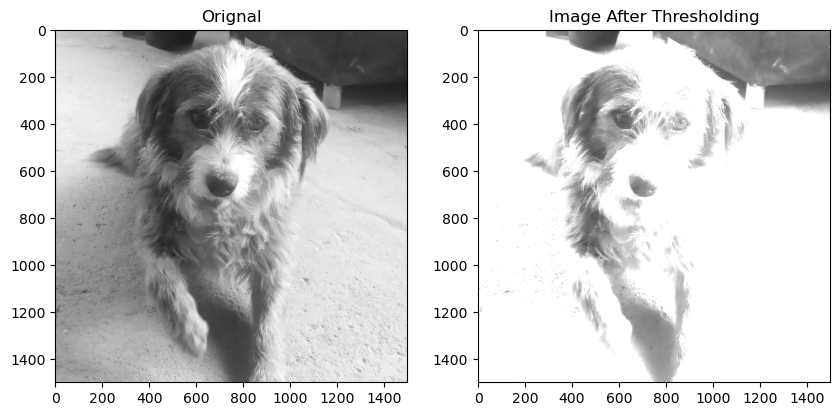

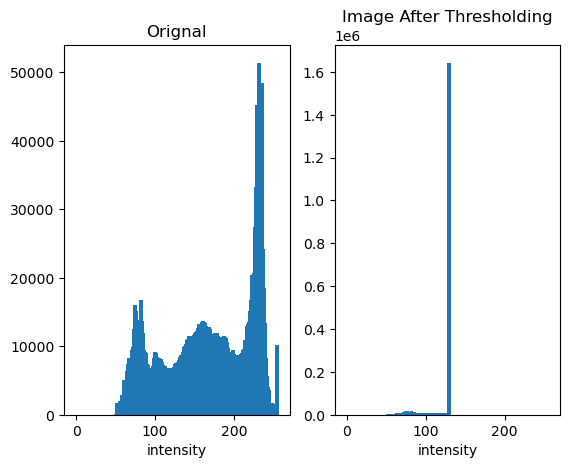

In [170]:
ret, new_image = cv2.threshold(image,130,255,cv2.THRESH_TRUNC) #NO CAMBIA VALORES SI LOS PIXELES SON MENORES AL UMBRAL
plot_image(image,new_image,"Orignal","Image After Thresholding")
plot_hist(image, new_image,"Orignal","Image After Thresholding")